In [41]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
import imblearn
from imblearn.over_sampling import SMOTE

In [2]:
# Set option to display all columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', None)



In [ ]:
'''Data Understanding and Preprocessing:
o Load and inspect the dataset.
o Handle missing values appropriately.
o Detect and handle outliers.

In [4]:
# Load the dataset

df=pd.read_excel(r'C:\Users\neha\Documents\Statistics\data11.xlsx')

In [5]:
# Display the first few rows

df.head()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan Â¥),Operating Profit Per Share (Yuan Â¥),Per Share Net profit before tax (Yuan Â¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.256969e-04,0.0,0.458143,0.000725,0.0,0.147950,0.147950,0.147950,0.169141,0.311664,0.017560,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,4.980000e+09,0.000327,0.263100,0.363725,0.002259,0.001208,0.629951,0.021266,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,0.001814,0.003487,1.820926e-04,1.165007e-04,0.032903,0.034164,0.392913,0.037135,0.672775,0.166673,0.190643,0.004094,0.001997,1.473360e-04,0.147308,0.334015,0.276920,0.001036,0.676269,0.721275,0.339077,0.025592,0.903225,0.002022,0.064856,7.010000e+08,6.550000e+09,0.593831,4.580000e+08,0.671568,0.424206,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.897851e-04,0.0,0.461867,0.000647,0.0,0.182251,0.182251,0.182251,0.208944,0.318137,0.021144,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,6.110000e+09,0.000443,0.264516,0.376709,0.006016,0.004039,0.635172,0.012502,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.397725,0.064468,0.001286,0.004917,9.360000e+09,7.190000e+08,0.025484,0.0

In [6]:
# Display information about dataset 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt?                                                 6819 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

In [7]:
# Display the rows and columns 
df.shape

(6819, 96)

In [8]:
# Display the columns name
df.columns

Index(['Bankrupt?', ' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)', ' Operating Expense Rate',
       ' Research and development expense rate', ' Cash flow rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Net Value Per Share (B)', ' Net Value Per Share (A)',
       ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons',
       ' Cash Flow Per Share', ' Revenue Per Share (Yuan Â¥)',
       ' Operating Profit Per Share (Yuan Â¥)',
       ' Per Share Net profit before tax (Yuan Â¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Operating Pro

In [9]:
# Information about the data types of each column in the DataFrame
df.dtypes

Bankrupt?                                                     int64
 ROA(C) before interest and depreciation before interest    float64
 ROA(A) before interest and % after tax                     float64
 ROA(B) before interest and depreciation after tax          float64
 Operating Gross Margin                                     float64
 Realized Sales Gross Margin                                float64
 Operating Profit Rate                                      float64
 Pre-tax net Interest Rate                                  float64
 After-tax net Interest Rate                                float64
 Non-industry income and expenditure/revenue                float64
 Continuous interest rate (after tax)                       float64
 Operating Expense Rate                                     float64
 Research and development expense rate                      float64
 Cash flow rate                                             float64
 Interest-bearing debt interest rate            

In [10]:
# It is used to detect missing values in a DataFrame and count the number of missing values in each column.
df.isnull().sum()   

Bankrupt?                                                   0
 ROA(C) before interest and depreciation before interest    0
 ROA(A) before interest and % after tax                     0
 ROA(B) before interest and depreciation after tax          0
 Operating Gross Margin                                     0
 Realized Sales Gross Margin                                0
 Operating Profit Rate                                      0
 Pre-tax net Interest Rate                                  0
 After-tax net Interest Rate                                0
 Non-industry income and expenditure/revenue                0
 Continuous interest rate (after tax)                       0
 Operating Expense Rate                                     0
 Research and development expense rate                      0
 Cash flow rate                                             0
 Interest-bearing debt interest rate                        0
 Tax rate (A)                                               0
 Net Val

In [11]:
# It is used to identify and count the number of duplicate rows in a DataFrame.
df.duplicated().sum()

0

In [51]:
# It is used to compute pairwise correlation coefficients between the numerical columns in a DataFrame
df.corr()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan Â¥),Operating Profit Per Share (Yuan Â¥),Per Share Net profit before tax (Yuan Â¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
Bankrupt?,1.000000,-0.239543,-0.239500,-0.241993,-0.140042,-0.139272,-0.193856,-0.238036,-0.239484,-0.214507,-0.248585,-0.006083,-0.024764,-0.120201,0.097928,-0.121220,-0.214143,-0.213725,-0.212643,-0.256159,-0.115611,-0.067166,-0.190741,-0.246001,-0.096151,-0.107083,-0.146503,-0.143949,-0.141603,-0.053331,-0.216739,-0.114126,-0.088168,-0.154300,-0.158537,-0.109211,0.272914,0.246535,-0.246535,-0.078714,0.278367,0.033151,-0.190264,-0.247467,0.104791,-0.078190,-0.014209,0.042544,-0.001376,0.077481,0.018950,0.025917,-0.180514,0.113516,-0.193536,-0.086383,-0.044823,-0.115155,-0.151713,-0.088781,0.193564,-0.119318,-0.043259,-0.048479,-0.020812,-0.164342,0.216619,0.092509,-0.255218,-0.221799,0.102058,0.059812,0.025814,-0.137433,-0.018035,-0.082458,0.070408,-0.020812,0.216619,0.140383,-0.075599,-0.060652,-0.122482,-0.085353,0.229231,0.139212,-0.255797,0.065817,-0.110684,-0.140041,-0.251917,0.246176,-0.129292,-0.110761,NaN,-0.161036
ROA(C) before interest and depreciation before interest,-0.239543,1.000000,0.941564,0.988614,0.471126,0.468962,0.794920,0.823454,0.810364,0.410102,0.836030,0.066191,0.113862,0.484638,-0.077546,0.307661,0.588946,0.588611,0.588297,0.893970,0.508274,0.295987,0.822893,0.881307,0.377913,0.430036,0.482614,0.481341,0.490834,0.056342,0.600193,0.533520,0.359252,0.220987,0.266460,0.078952,-0.275015

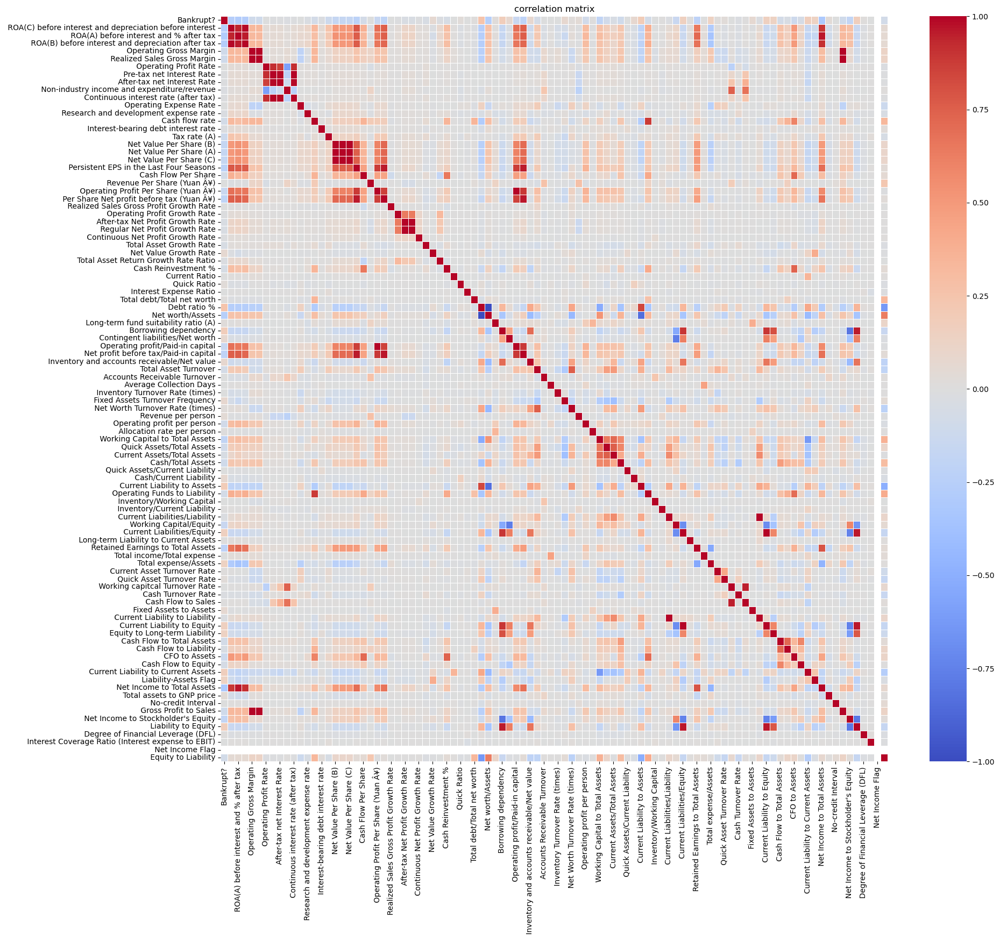

In [13]:
#calculates the pairwise correlation coefficients between the numerical columns in the DataFrame 
correlation_matrix=df.corr()

# It creates a new figure for plotting with matplotlib. The figsize parameter specifies the dimensions of the figure in inches.
plt.figure(figsize=(20,18))

# it creates a heatmap using seaborn's heatmap function.
sns.heatmap(correlation_matrix,cmap='coolwarm',fmt='.2f',linewidths=0.5) 

#This line sets the title of the plot to 'Correlation Matrix'
plt.title('correlation matrix')

#This line displays the plot. 
plt.show()

In [15]:
# create a new dataframe 
newdf=df.drop(['Bankrupt?',' Liability-Assets Flag',' Net Income Flag'],axis=1)

In [16]:
columns=newdf.columns

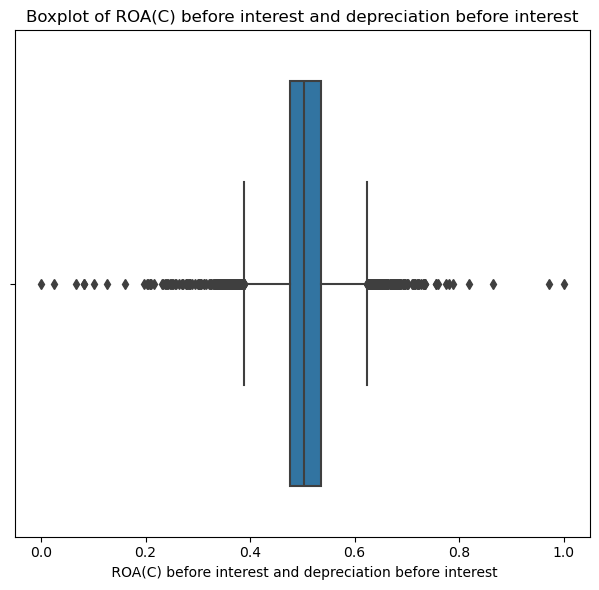

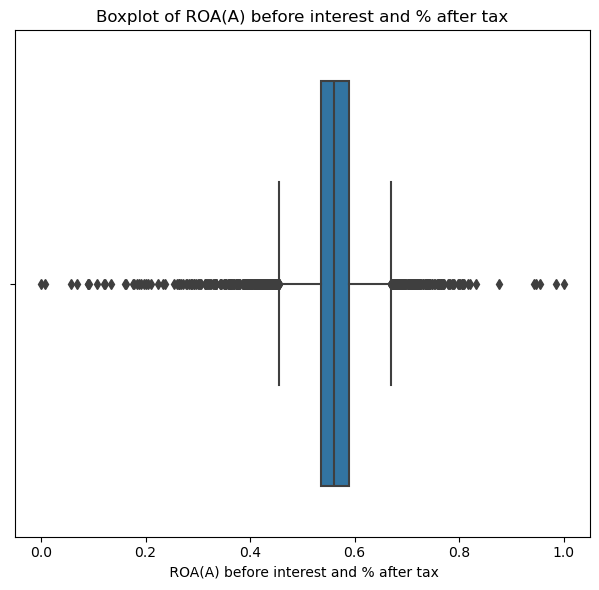

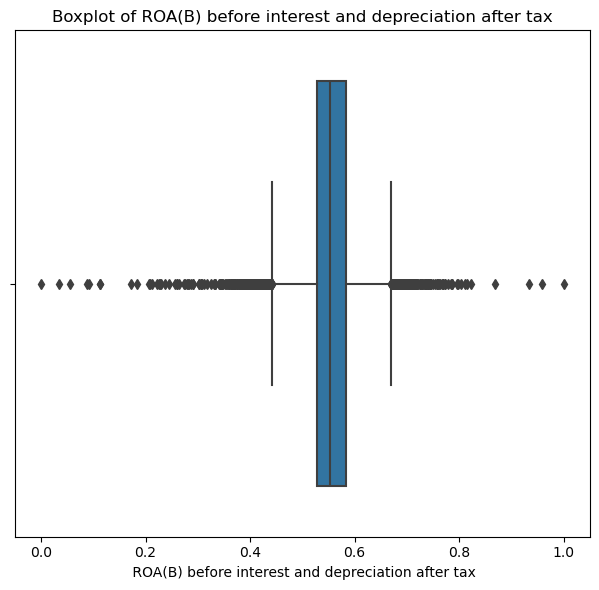

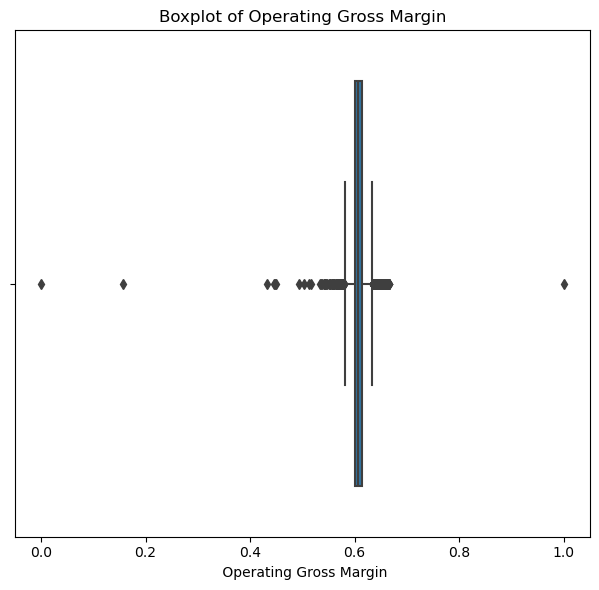

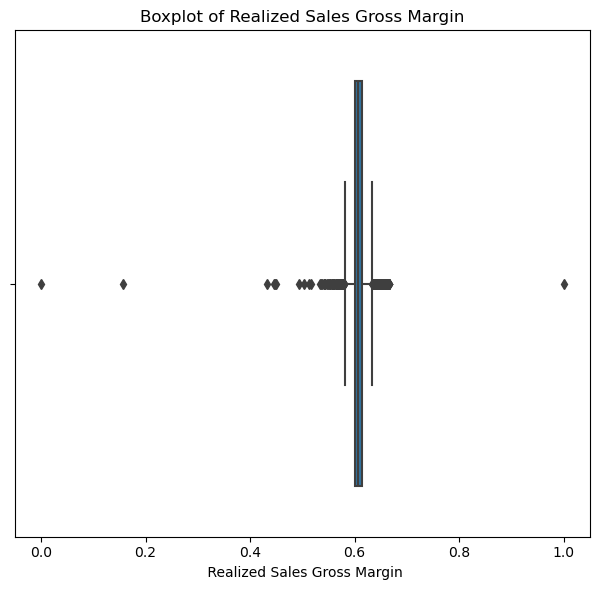

...

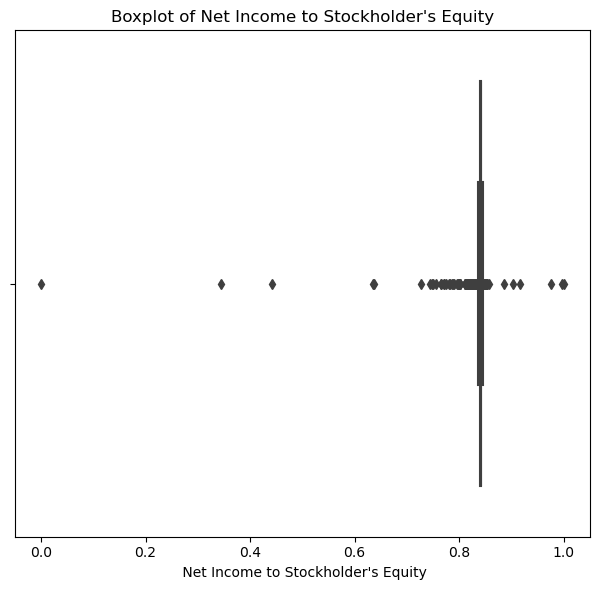

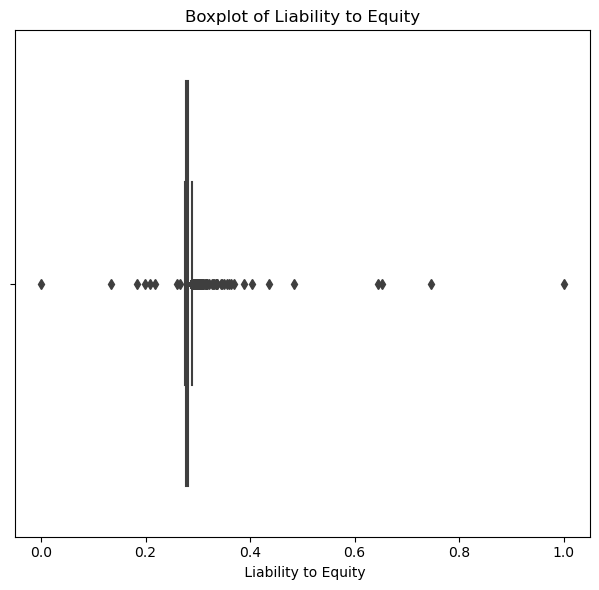

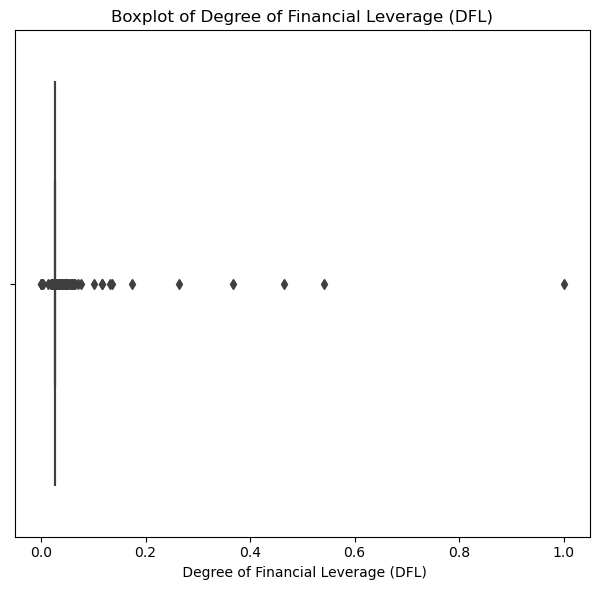

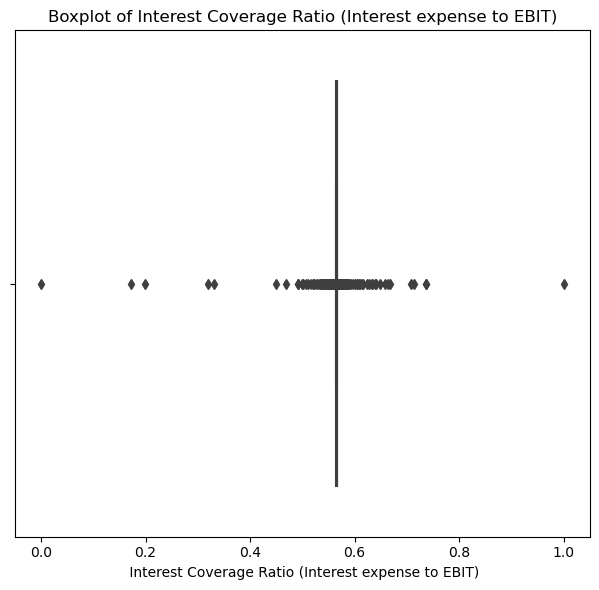

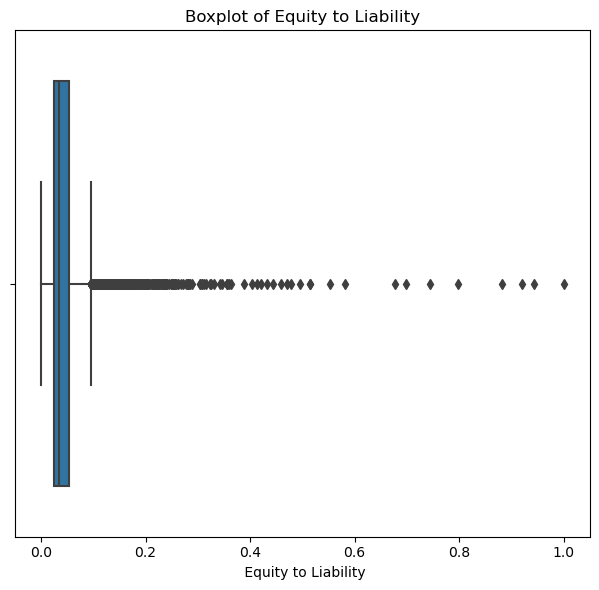

In [17]:
for col in columns:
    plt.figure(figsize=(12,6)) #This line creates a new figure for plotting.
    plt.subplot(1,2,2)          
    sns.boxplot(x=col,data=df)  #This line generates a boxplot for the specified column.
    plt.title(f'Boxplot of{col}')  # This line sets the title for the boxplot.

    plt.tight_layout()  #This function adjusts the padding between and around subplots.
    plt.show()

In [18]:
def impute(x):
    Q3=df[x].quantile(0.75)    ## Calculate the 75th percentile (third quartile) of the column x
    Q1=df[x].quantile(0.25)    ## Calculate the 25th percentile (first quartile) of the column x
    IQR=Q3-Q1                  ## Calculate the Interquartile Range (IQR) of the column x
    lb=Q1-1.5*(IQR)            ## Calculate the lower bound using IQR and a factor of 1.5
    ub=Q3+1.5*(IQR)            ## Calculate the upper bound using IQR and a factor of 1.5
   
    # # Identify and replace outliers
    idx=np.where(df[x]>ub)     ## Find indices where values exceed the upper bound
    idx=np.where(df[x]>ub)     

    df[x].iloc[idx]=ub         ## Replace these values with the upper bound
    idx=np.where(df[x]<lb)     ## Find indices where values are below the lower bound
    df[x].iloc[idx]=lb         ## Replace these values with the lower bound

In [19]:

##  Iterate through each column name in `columns` and apply the `impute` function
for col in columns:
    impute(col)

C:\Users\neha\AppData\Local\Temp\ipykernel_10608\165356404.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[x].iloc[idx]=ub
C:\Users\neha\AppData\Local\Temp\ipykernel_10608\165356404.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[x].iloc[idx]=lb
C:\Users\neha\AppData\Local\Temp\ipykernel_10608\165356404.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[x].iloc[idx]=ub
C:\Users\neha\AppData\Local\Temp\ipykernel_10608

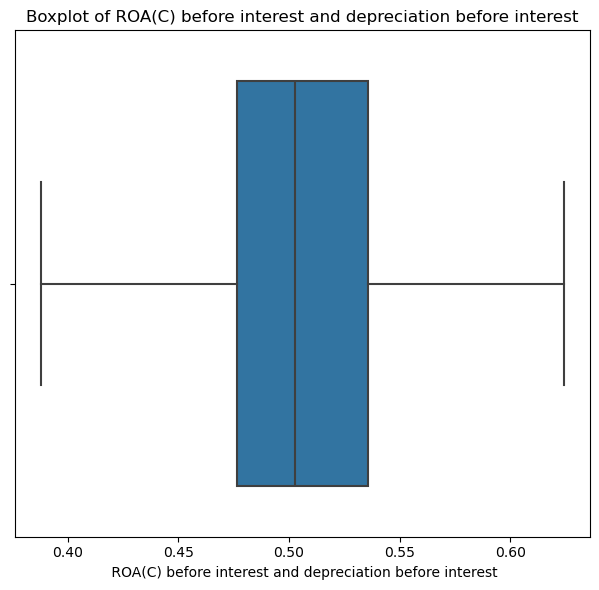

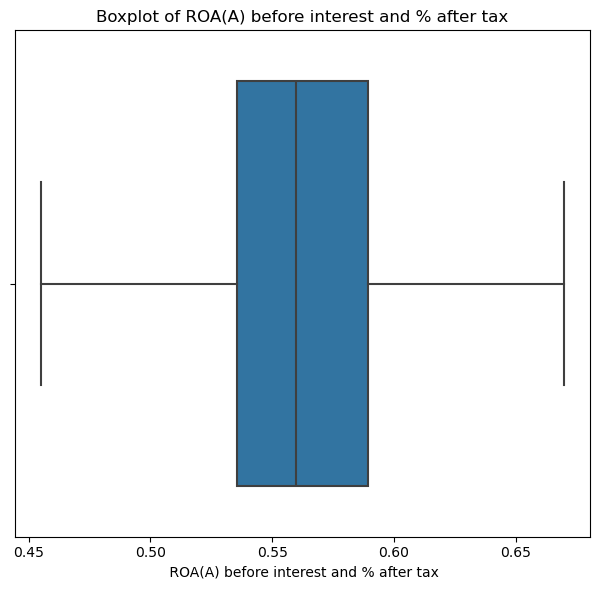

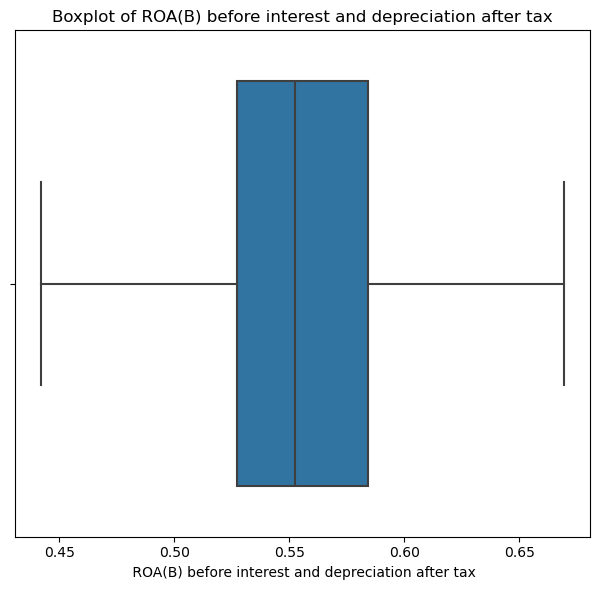

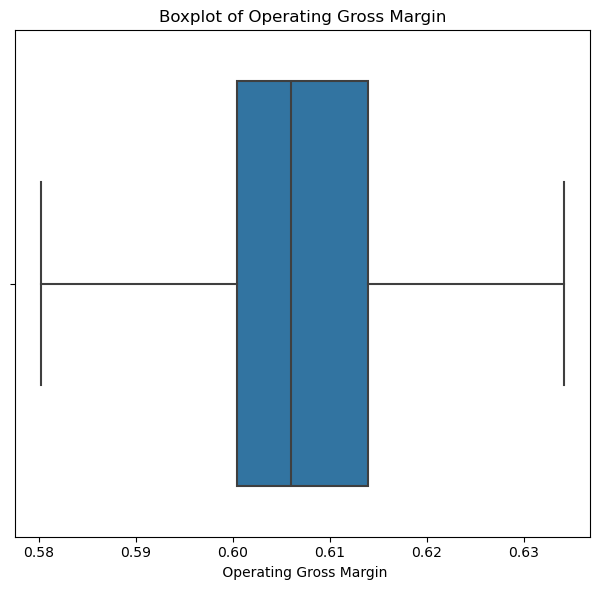

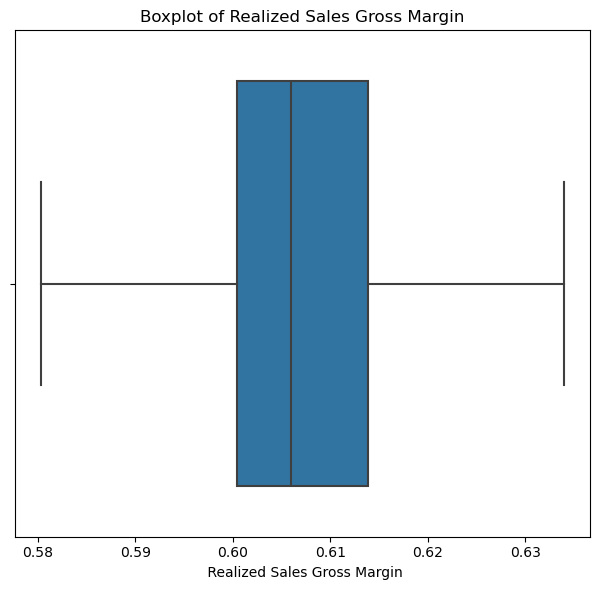

...

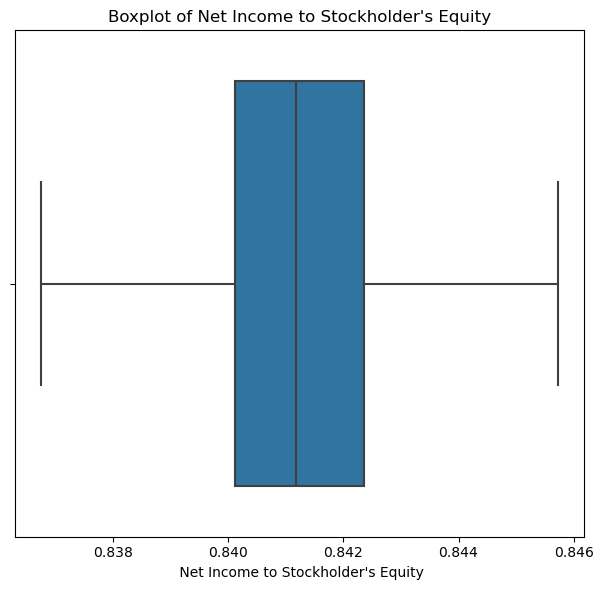

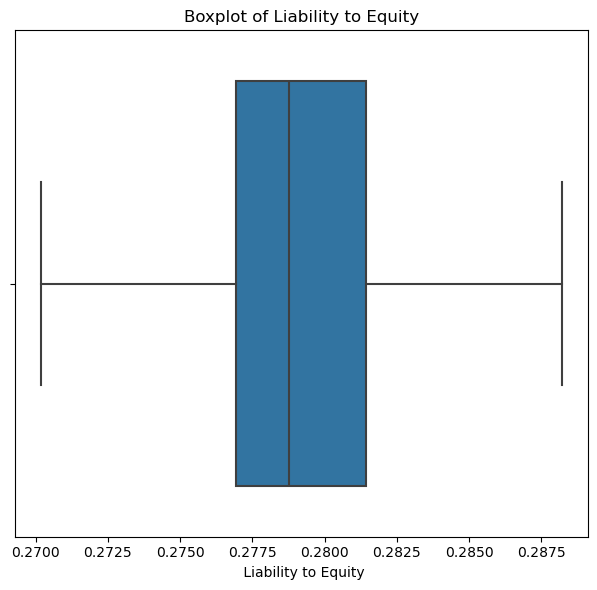

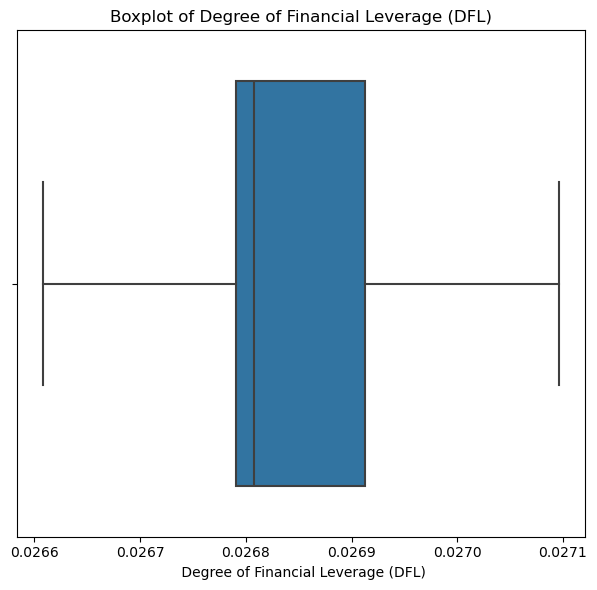

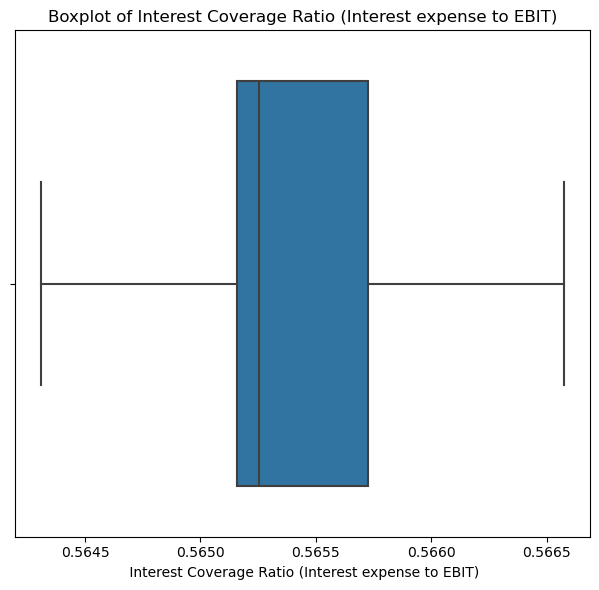

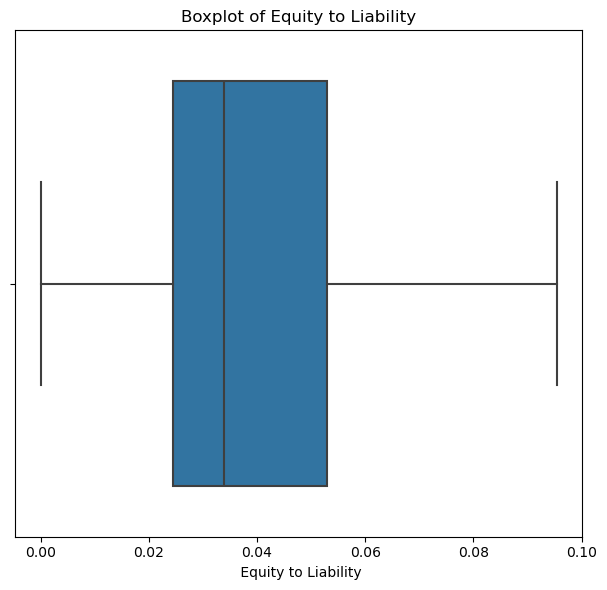

In [20]:
# Iterate through each column name in `columns` and create boxplots
for col in columns:
    plt.figure(figsize=(12,6))   # Set figure size for each plot
    plt.subplot(1,2,2)           # Create boxplot for the current column `col`
    sns.boxplot(x=col,data=df)
    plt.title(f'Boxplot of{col}')

    plt.tight_layout()          ## Adjust layout to prevent overlapping
    plt.show()

In [ ]:
'''EDA 
o Generate descriptive statistics.
o Visualize feature distributions and target variable.
o Analyze relationships between features and the target variable.

In [21]:
# Generate descriptive statistics.

df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Bankrupt?,6819.0,3.226280e-02,1.767102e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
ROA(C) before interest and depreciation before interest,6819.0,5.056674e-01,5.148332e-02,3.879735e-01,4.765271e-01,5.027056e-01,5.355628e-01,6.241164e-01
ROA(A) before interest and % after tax,6819.0,5.605075e-01,5.008748e-02,4.551216e-01,5.355430e-01,5.598016e-01,5.891572e-01,6.695786e-01
ROA(B) before interest and depreciation after tax,6819.0,5.546905e-01,5.027659e-02,4.420338e-01,5.272766e-01,5.522780e-01,5.841051e-01,6.693479e-01
Operating Gross Margin,6819.0,6.078342e-01,1.075818e-02,5.802404e-01,6.004447e-01,6.059975e-01,6.139142e-01,6.341184e-01
Realized Sales Gross Margin,6819.0,6.078118e-01,1.072502e-02,5.803215e-01,6.004338e-01,6.059759e-01,6.138421e-01,6.339544e-01
Operating Profit Rate,6819.0,9.990277e-01,1.204911e-04,9.987812e-01,9.989692e-01,9.990222e-01,9.990945e-01,9.992825e-01
Pre-tax net Interest Rate,6819.0,7.974675e-01,1.885042e-04,7.970964e-01,7.973859e-01,7.974636e-01,7.975788e-01,7.978683e-01
After-tax net Interest Rate,6819.0,8.093777e-01,1.573012e-04,8.090751e-01,8.093116e-01,8.093752e-01,8.094693e-01,8.097058e-01
Non-industry income and expenditure/revenue,6819.0,3.035260e-01,1.237548e-04,3.032879e-01,3.034663e-01,3.035255e-01,3.035852e-01,3.037636e-01


In [ ]:
# Visualize feature distributions and target variable.


C:\Users\neha\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


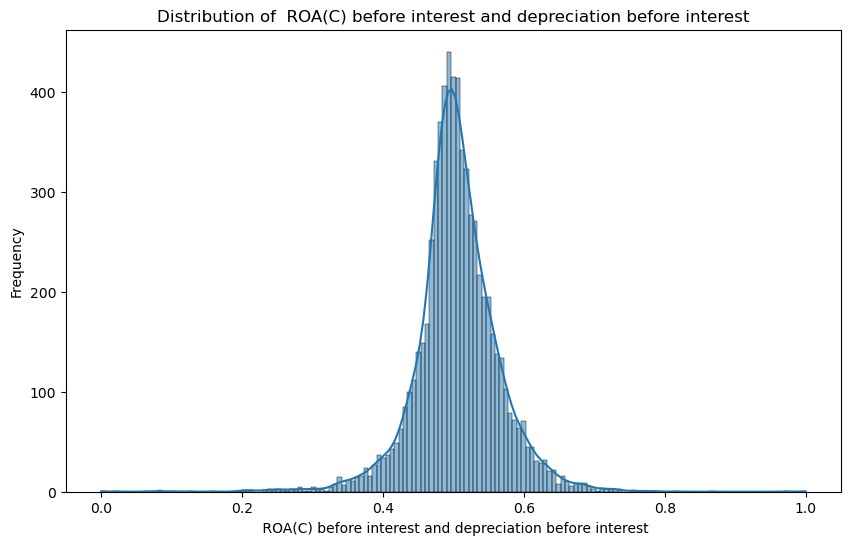

C:\Users\neha\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


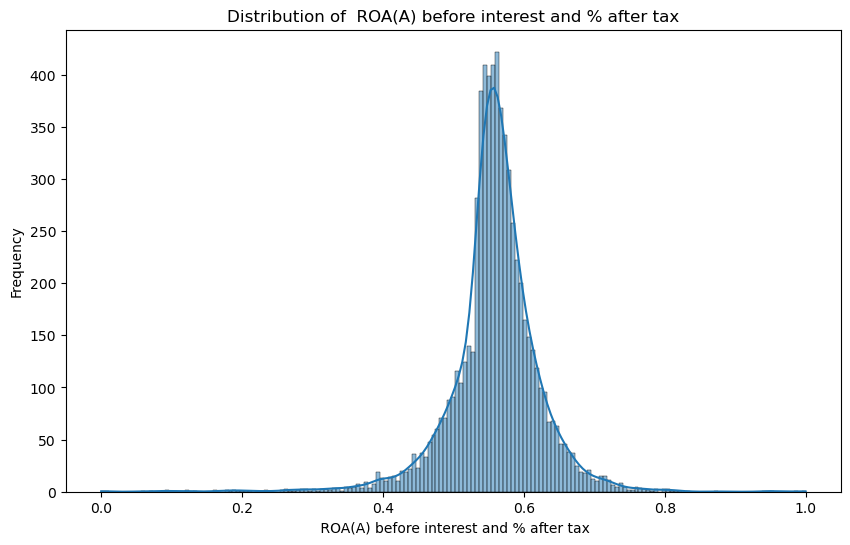

C:\Users\neha\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


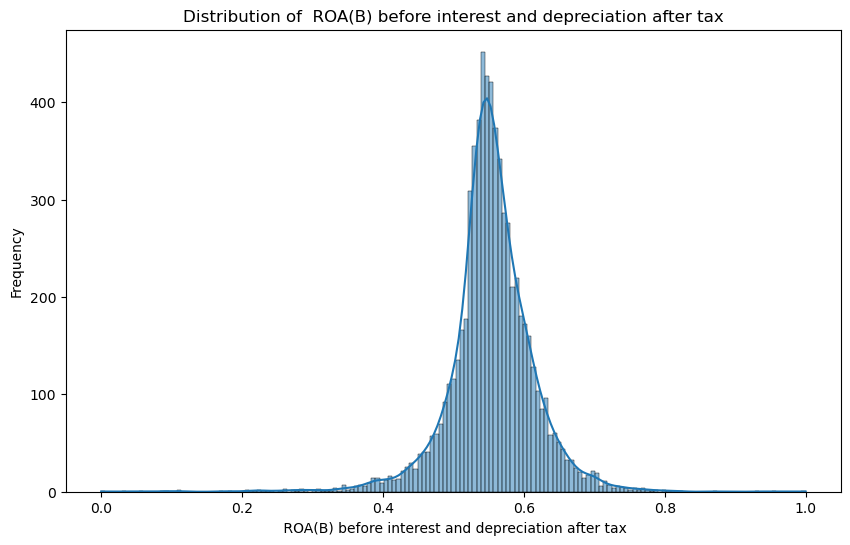

C:\Users\neha\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


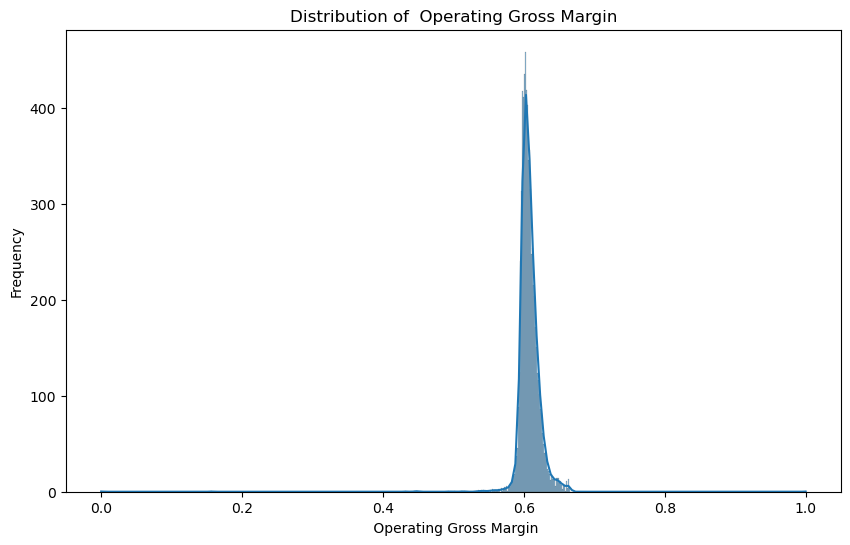

C:\Users\neha\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


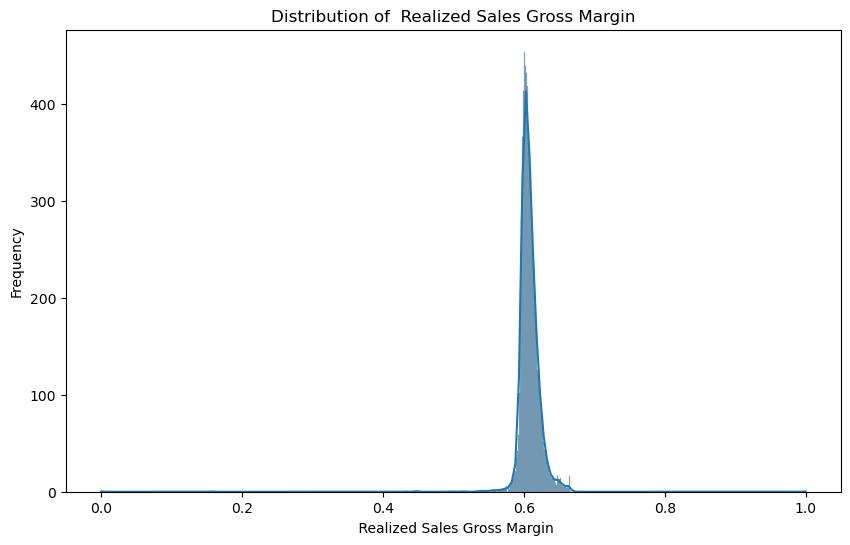

C:\Users\neha\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):

KeyboardInterrupt



Error in callback <function _draw_all_if_interactive at 0x0000025286111260> (for post_execute), with arguments args (),kwargs {}:



KeyboardInterrupt



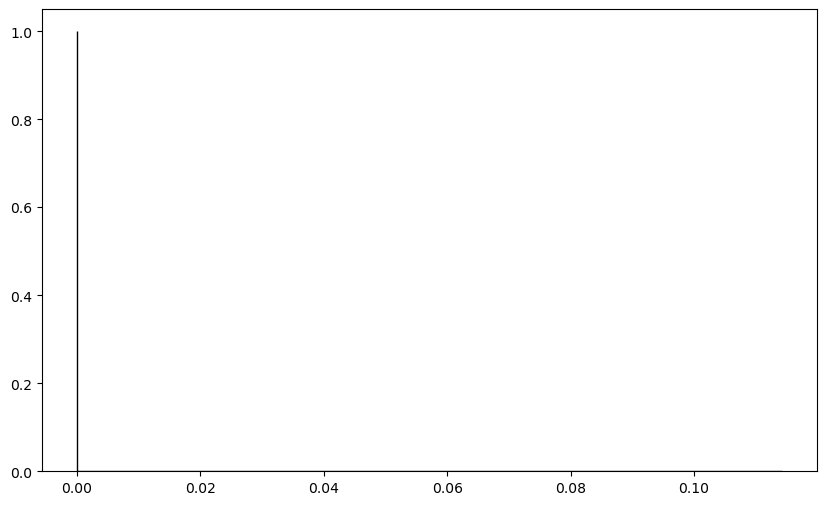

In [22]:
for col in columns:
    plt.figure(figsize=(10, 6))
    sns.histplot(newdf[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

In [ ]:
## Calculate value counts for the column 'Bankrupt?'

df['Bankrupt?'].value_counts()

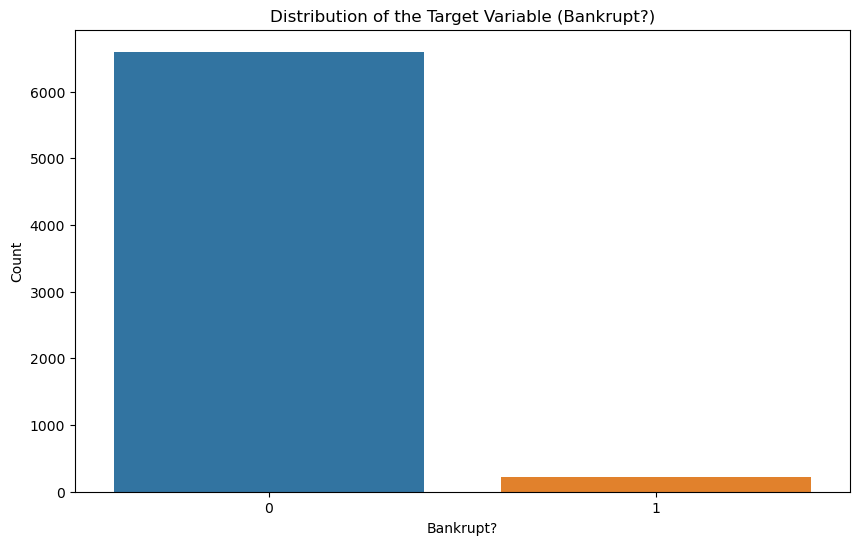

In [23]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Bankrupt?', data=df)
plt.title('Distribution of the Target Variable (Bankrupt?)')
plt.xlabel('Bankrupt?')
plt.ylabel('Count')
plt.show()

In [ ]:
#o Analyze relationships between features and the target variable.

In [26]:
# Compute the correlation matrix
corr_matrix = df.corr()

# Correlation with the target variable ('Bankrupt?')
corr_with_target = corr_matrix['Bankrupt?'].sort_values(ascending=False)


# Print the correlations
print(corr_with_target)

Bankrupt?                                                   1.000000
 Borrowing dependency                                       0.278367
 Total debt/Total net worth                                 0.272914
 Debt ratio %                                               0.246535
 Liability to Equity                                        0.246176
 Current Liability to Current Assets                        0.229231
 Current Liability to Equity                                0.216619
 Current Liabilities/Equity                                 0.216619
 Current Liability to Assets                                0.193564
 Equity to Long-term Liability                              0.140383
 Liability-Assets Flag                                      0.139212
 Allocation rate per person                                 0.113516
 Inventory and accounts receivable/Net value                0.104791
 Total expense/Assets                                       0.102058
 Interest-bearing debt interest ra

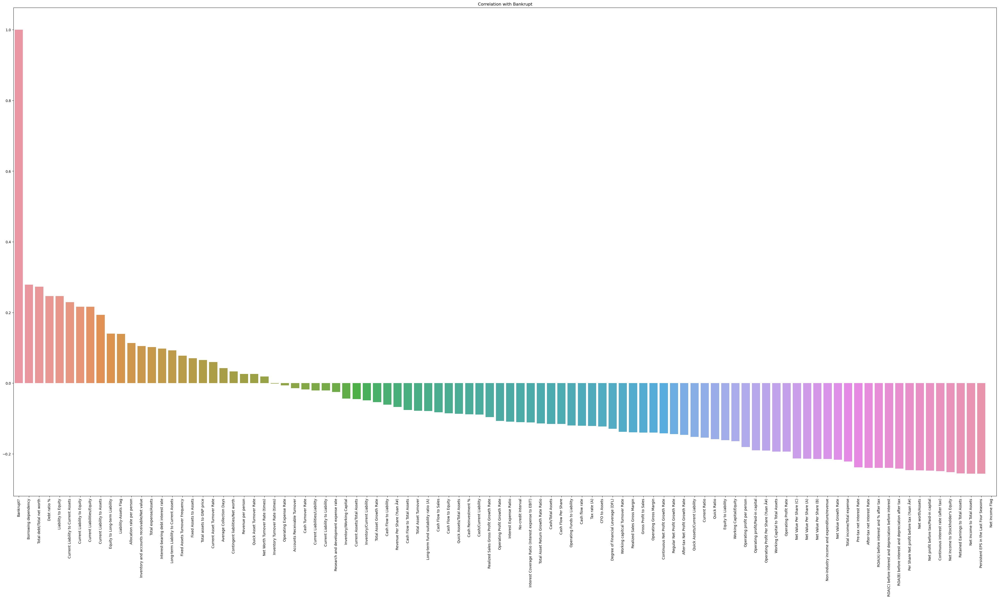

In [27]:
# Plot the correlations
plt.figure(figsize=(50, 25))
sns.barplot(x=corr_with_target.index, y=corr_with_target.values)
plt.xticks(rotation=90)
plt.title('Correlation with Bankrupt')
plt.show()

C:\Users\neha\anaconda3\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)


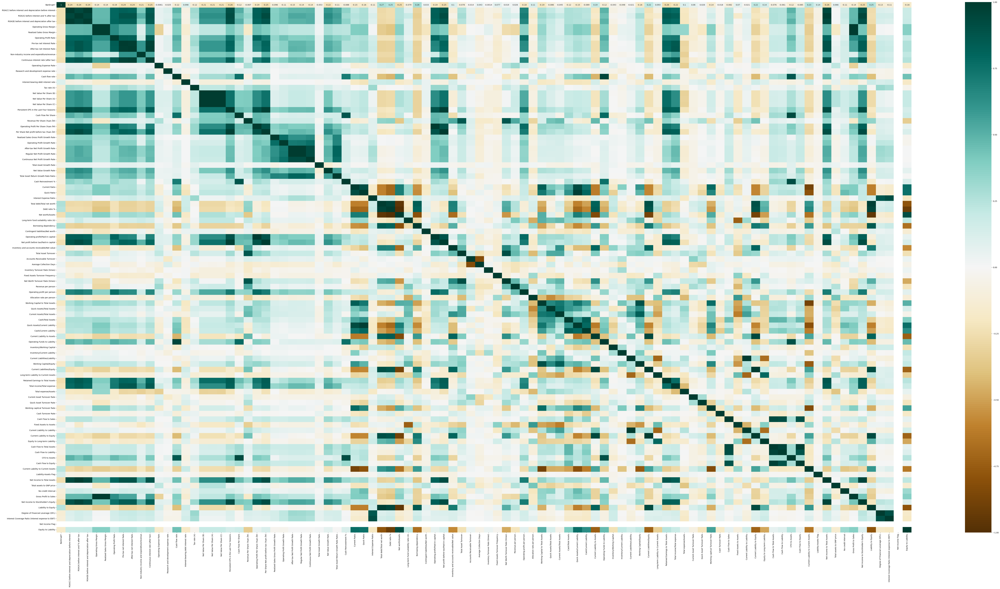

In [35]:
plt.figure(figsize=(100,50))
corr = df.corr()
sns.heatmap(corr, cmap="BrBG",annot=True)
corr
plt.show()

In [36]:
corr_matrix = df.corr()
threshold = 0.2
corr_with_target = corr_matrix['Bankrupt?'].abs()
relevant_features = corr_with_target[corr_with_target > threshold].index.tolist()
df1 = df[relevant_features]
df1

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan Â¥),Net Value Growth Rate,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Current Liabilities/Equity,Retained Earnings to Total Assets,Total income/Total expense,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
0,1,0.387973,0.455122,0.442034,0.797096,0.809075,0.303288,0.781314,0.147950,0.147950,0.147950,0.178548,0.138736,0.000353,0.018673,0.207576,0.792424,0.385425,0.137757,0.338662,0.910524,0.002022,0.338662,0.068886,0.752193,0.836752,0.288207
1,1,0.464291,0.538214,0.516730,0.797380,0.809301,0.303556,0.781506,0.182251,0.182251,0.182251,0.208944,0.169918,0.000443,0.012502,0.171176,0.828824,0.376760,0.168962,0.329740,0.931065,0.002226,0.329740,0.047775,0.795297,0.839969,0.283846
2,1,0.426071,0.499019,0.472295,0.797096,0.809075,0.303288,0.781314,0.177911,0.177911,0.193713,0.180581,0.142803,0.000396,0.018673,0.207516,0.792484,0.379093,0.148036,0.334777,0.910524,0.002060,0.334777,0.025346,0.774670,0.836774,0.288207
3,1,0.399844,0.455122,0.457733,0.797096,0.809075,0.303350,0.781314,0.154187,0.154187,0.154187,0.193722,0.148603,0.000382,0.009572,0.151465,0.848535,0.379743,0.147561,0.331509,0.910524,0.001851,0.331509,0.067250,0.752193,0.836752,0.281721
4,1,0.465022,0.538432,0.522298,0.797366,0.809304,0.303475,0.781550,0.167502,0.167502,0.167502,0.212537,0.168412,0.000439,0.005150,0.106509,0.893491,0.375025,0.167461,0.330726,0.913850,0.002224,0.330726,0.047725,0.795016,0.839973,0.278514
5,1,0.388680,0.455122,0.442034,0.797096,0.809075,0.303288,0.781314,0.155577,0.155577,0.155577,0.178548,0.138811,0.000353,0.014213,0.180427,0.819573,0.381448,0.137825,0.335534,0.910524,0.001866,0.335534,0.068886,0.752193,0.836752,0.285087
6,0,0.390923,0.455122,0.442034,0.797096,0.809075,0.303288,0.781314,0.158822,0.158822,0.158822,0.178548,0.135686,0.000353,0.018673,0.216102,0.783898,0.384999,0.136030,0.337392,0.911441,0.002121,0.337392,0.060765,0.752193,0.836752,0.288207
7,0,0.508361,0.570922,0.559077,0.797449,0.809362,0.303545,0.781621,0.176984,0.176984,0.176984,0.225206,0.180462,0.000451,0.005278,0.108202,0.891798,0.374219,0.179519,0.329804,0.935449,0.002360,0.329804,0.030201,0.815350,0.841459,0.278607
8,0,0.488519,0.545137,0.543284,0.797414,0.809338,0.303584,0.781598,0.184189,0.184189,0.184189,0.218398,0.173157,0.000453,0.002266,0.058591,0.941409,0.370253,0.172159,0.328093,0.935200,0.002274,0.328093,0.021710,0.803647,0.840487,0.276423
9,0,0.495686,0.550916,0.542963,0.797404,0.809320,0.303483,0.781574,0.177447,0.177447,0.177447,0.217831,0.176621,0.000445,0.006354,0.121293,0.878707,0.374509,0.175658,0.330409,0.938290,0.002269,0.330409,0.025494,0.804195,0.840688,0.279388


In [37]:
from scipy.stats import ttest_ind

# Hypothesis testing for feature selection
features = []
for column in df.select_dtypes(include=[np.number]).columns:
    if column != 'Bankrupt?':
        bankrupt = df[df['Bankrupt?'] == 1][column]
        non_bankrupt = df[df['Bankrupt?'] == 0][column]
        t_stat, p_val = ttest_ind(bankrupt, non_bankrupt)
        if p_val < 0.05:        # if null hypothesis is rejected select that column
            features.append(column)
        print(f'{column}: t-statistic={t_stat}, p-value={p_val}')

print(f'Significant features: {len(features)}')

features.append('Bankrupt?')    # appeded bankrupt? column in list

 ROA(C) before interest and depreciation before interest: t-statistic=-20.371000246550334, p-value=1.3480464196848798e-89
 ROA(A) before interest and % after tax: t-statistic=-20.36708962978169, p-value=1.453424003163958e-89
 ROA(B) before interest and depreciation after tax: t-statistic=-20.59226229040652, p-value=1.867512034084068e-91
 Operating Gross Margin: t-statistic=-11.677652430250529, p-value=3.2823739125123346e-31
 Realized Sales Gross Margin: t-statistic=-11.61220032059553, p-value=6.967922607227421e-31
 Operating Profit Rate: t-statistic=-16.315267033012432, p-value=9.863440509107752e-59
 Pre-tax net Interest Rate: t-statistic=-20.235075270990965, p-value=1.8306696788047566e-88
 After-tax net Interest Rate: t-statistic=-20.36563281120137, p-value=1.4947479061257353e-89
 Non-industry income and expenditure/revenue: t-statistic=-18.132844472521544, p-value=8.370733607811912e-72
 Continuous interest rate (after tax): t-statistic=-21.189549801114605, p-value=1.4678863402201738e

C:\Users\neha\anaconda3\Lib\site-packages\scipy\stats\_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


In [38]:
data = df[features] 

In [39]:
from sklearn.decomposition import PCA
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Feature Engineering
#data['NewFeature'] = data[' Total Asset Growth Rate'] / data[' Net Income to Total Assets']

# Dimensionality reduction
pca = PCA(n_components=10)
principal_components = pca.fit_transform(data.drop(['Bankrupt?'], axis=1))
data_pca = pd.DataFrame(data=principal_components)

# Feature selection
X = data.drop(['Bankrupt?'], axis=1)
y = data['Bankrupt?']
model = LogisticRegression(max_iter=10000)
rfe = RFE(model)
fit = rfe.fit(X, y)
selected_features = X.columns[fit.support_]

print(f'Selected features: {selected_features}')

Selected features: Index([' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)',
       ' Research and development expense rate', ' Cash flow rate',
       ' Cash Flow Per Share', ' Operating Profit Growth Rate',
       ' After-tax Net Profit Growth Rate', ' Regular Net Profit Growth Rate',
       ' Total Asset Growth Rate', ' Cash Reinvestment %',
       ' Interest Expense Ratio', ' Net worth/Assets', ' Borrowing dependency',
       ' Inventory and accounts receivable/Net value',
       ' Operating profit per person', ' Working Capital to Total Assets',
       ' Quick Assets/Total Assets', ' Current Asset

In [48]:

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler

# Splitting the data

X_train, X_test, y_train, y_test = train_test_split(X[selected_features], y, test_size=0.2, random_state=42)
# Apply StandardScaler to the data

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

# Model training
model.fit(X_train_resampled, y_train_resampled)

# Model evaluation
y_pred = model.predict(X_test_scaled)
print('Accuracy:', accuracy_score(y_test, y_pred))
print('Precision:', precision_score(y_test, y_pred))
print('Recall:', recall_score(y_test, y_pred))
print('F1 Score:', f1_score(y_test, y_pred))
print('ROC AUC Score:', roc_auc_score(y_test, y_pred))

Accuracy: 0.8636363636363636
Precision: 0.1889400921658986
Recall: 0.803921568627451
F1 Score: 0.30597014925373134
ROC AUC Score: 0.8349386974896584


In [49]:
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

Confusion Matrix:
[[1137  176]
 [  10   41]]


In [50]:
print('prediction accuracy',1137/(1137+10+176))


prediction accuracy 0.8594104308390023


# Key Insights
- Accuracy (0.864):
Accuracy measures the overall correctness of predictions. An accuracy of 0.864 indicates that 86.4% of predictions were correct. However, accuracy alone may not provide a complete picture, especially in imbalanced datasets where the majority class dominates.

- Precision (0.189):
Precision measures the proportion of true positive predictions among all positive predictions made by the model. A low precision (0.189) suggests that when the model predicts an instance as positive (e.g., bankruptcy), it is correct only 18.9% of the time. This indicates a high rate of false positives.

- Recall (0.804):
Recall (or sensitivity) measures the proportion of actual positives that were correctly identified by the model. A recall of 0.804 indicates that the model correctly identifies 80.4% of all actual bankruptcies. This metric is relatively higher compared to precision, suggesting that the model is better at capturing true positives.

- F1 Score (0.306):
The F1 score combines precision and recall into a single metric and is useful when dealing with imbalanced datasets. A low F1 score (0.306) indicates that there is room for improvement in both precision and recall.

- ROC AUC Score (0.835):
The Receiver Operating Characteristic Area Under the Curve (ROC AUC) score measures the ability of the model to distinguish between classes (bankrupt vs. non-bankrupt). A score of 0.835 indicates a relatively good performance, with higher values suggesting better discrimination between classes.

# Implications for Financial Risk Management
- Model Performance Evaluation:
The metrics suggest that while the model shows good discrimination (high ROC AUC score), there are significant challenges in correctly identifying bankruptcies (low precision) without generating too many false alarms.

- Risk Identification and Mitigation:
Financial institutions can use such models to identify companies at risk of bankruptcy early. Despite the challenges with precision, the high recall implies that the model can capture a significant portion of companies actually facing financial distress.

- Enhanced Decision Support:
Incorporating these predictive models into decision-making processes can help allocate resources more efficiently. Financial analysts can focus on high-risk companies identified by the model for closer scrutiny and proactive risk management strategies.

- Continuous Model Improvement:
There is a need to improve the model's precision to reduce false positives, which can lead to unnecessary interventions or resource allocations. This could involve refining feature selection, incorporating domain knowledge, or exploring different modeling techniques.

- Regulatory Compliance and Reporting:
Organizations can use these models to enhance regulatory compliance by identifying potential risks early and taking appropriate actions. This helps in maintaining financial stability and meeting regulatory requirements effectively.

- Stress Testing and Scenario Analysis:
Financial institutions can leverage predictive models to conduct stress testing and scenario analysis. By simulating adverse economic conditions, they can assess the resilience of their portfolios to potential bankruptcies and economic downturns.